In [3]:
#from google.colab import drive
#drive.mount('/content/drive')

In [1]:
!git clone https://github.com/mastryukov1990/mok_mas_gan2

Cloning into 'mok_mas_gan2'...
remote: Enumerating objects: 1365, done.
remote: Counting objects: 100% (1365/1365), done.
remote: Compressing objects: 100% (1196/1196), done.
remote: Total 1365 (delta 200), reused 1321 (delta 156), pack-reused 0
Receiving objects: 100% (1365/1365), 12.93 MiB | 32.85 MiB/s, done.
Resolving deltas: 100% (200/200), done.


In [2]:
import torch
import torch.nn as nn
import torch.utils.data as data
from torchvision import transforms
from torchvision import datasets
from torch import functional as F
from torchvision.models import vgg19
from PIL import Image
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import random
import sys

In [3]:
sys.path.append("/content/mok_mas_gan2")

In [4]:
from RaGAN import *
# from RaGAN.AL import AL
from RaGAN.DAL import DAL
from RaGAN.GAL import GAL
from RaGAN.Loss import MeanLoss, Loss
from RaGAN.SGRL import SGRL
from RaGAN.GL import GeometricLoss
from RaGAN.FML import FML
from RaGAN.conf import IMSIZE, DEVICE
from RaGAN.utils import imshow

In [5]:
img = Image.open('/content/mok_mas_gan2/RaGAN/256_256.jpg')
print(img.size)

(256, 256)


In [6]:
normal_transform = transforms.Compose(
    [
     transforms.ToTensor(),
     transforms.Resize((IMSIZE,IMSIZE), interpolation=Image.BICUBIC),
     transforms.Normalize(mean=[0.5] * 3, std=[0.5] * 3)
     ]
)

In [7]:
tr_img = normal_transform(img)


In [8]:
print(tr_img.size())


torch.Size([3, 128, 128])


In [9]:
def mask_image(image, mask_h, mask_w):
    sz = image.size()
    mask = torch.ones_like(image)
    rand_h = random.randint(0, sz[-2] - mask_h)
    rand_w = random.randint(0, sz[-1] - mask_w)
    mask[:, rand_h:rand_h + mask_h:, rand_w:rand_w + mask_w:] = 0
    return image * mask

In [10]:
class MaskTransform(object):
    def __init__(self, image_size):
        assert isinstance(image_size, (int, tuple))
        self.image_size = image_size

    def __call__(self, image):
        return self.__mask_image(image, self.image_size // 2, 
                                        self.image_size // 2) 
        

    def __mask_image(self, image, mask_h, mask_w):
        sz = image.size()
        mask = torch.zeros_like(image)
        rand_h =  sz[-2]//2 - mask_h//2
        rand_w =  sz[-1]//2 - mask_w//2
        mask[:, rand_h:rand_h + mask_h:, rand_w:rand_w + mask_w:] = 1
        return image * (1 - mask), mask

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


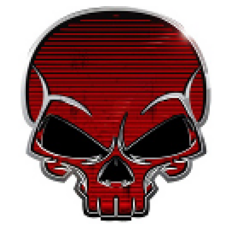

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


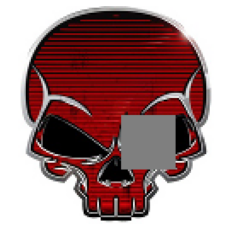

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


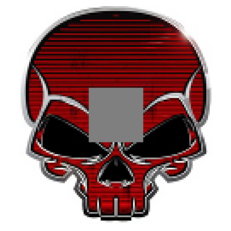

In [11]:
imshow(tr_img)
masked_image = mask_image(tr_img, 32, 32)
another_masked_image, mask = MaskTransform(64)(tr_img)
imshow(masked_image)
imshow(another_masked_image)

In [12]:
gen = JsonDataLoader('/content/mok_mas_gan2/RaGAN/generator.json')
gen_params = gen.get_data()

dis = JsonDataLoader('/content/mok_mas_gan2/RaGAN/discriminator.json')
dis_params = dis.get_data()

In [13]:
TRAIN_PATH = './train_data/'
TEST_PATH = './test_data'
IMAGE_SIZE = 128
CROP_SIZE = 160
BATCH_SIZE = 1



In [14]:

!mkdir data_faces && wget https://s3-us-west-1.amazonaws.com/udacity-dlnfd/datasets/celeba.zip 

--2020-11-27 16:11:32--  https://s3-us-west-1.amazonaws.com/udacity-dlnfd/datasets/celeba.zip
Resolving s3-us-west-1.amazonaws.com (s3-us-west-1.amazonaws.com)... 52.219.112.24
Connecting to s3-us-west-1.amazonaws.com (s3-us-west-1.amazonaws.com)|52.219.112.24|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 1443490838 (1.3G) [application/zip]
Saving to: ‘celeba.zip’

celeba.zip          100%[===================>]   1.34G  42.5MB/s    in 33s     

2020-11-27 16:12:05 (41.7 MB/s) - ‘celeba.zip’ saved [1443490838/1443490838]



In [15]:
import zipfile

with zipfile.ZipFile("celeba.zip","r") as zip_ref:
  zip_ref.extractall("data_faces/")



In [16]:
#train_data = datasets.CelebA(TRAIN_PATH, 'train', transform=normal_transform, download=True)
#test_data = datasets.CelebA(TEST_PATH, 'test', transform=normal_transform, download=True)

In [17]:
celeba_transform = transforms.Compose(
    [
     transforms.CenterCrop((CROP_SIZE, CROP_SIZE)),
     transforms.ToTensor(),
     transforms.Resize((IMSIZE,IMSIZE), interpolation=Image.BICUBIC),
     transforms.Normalize(mean=[0.5] * 3, std=[0.5] * 3),
    ]
)

In [18]:
class MaskDataset:
    def __init__(self, data_path, data_transform, mask_transform):
        self.dataholder = datasets.ImageFolder(data_path, transform=data_transform)
        self.mask_transform = mask_transform

    def __len__(self):
        return len(self.dataholder) //100

    def __getitem__(self, idx):
        image, label = self.dataholder.__getitem__(idx)
        masked_image = None
        if self.mask_transform is not None:
            masked_image, mask = self.mask_transform(image)
        if masked_image is not None:
            return {"gt" : image, "masked" : masked_image, "mask" : mask}
        return image
        



In [19]:
celeba_data = datasets.ImageFolder('./data_faces', transform=celeba_transform)
data_loader = data.DataLoader(celeba_data, batch_size=BATCH_SIZE, shuffle=True)

celeba_dataset = MaskDataset(data_path='./data_faces', 
                             data_transform=celeba_transform, mask_transform=MaskTransform(IMAGE_SIZE))
celeba_loader = data.DataLoader(celeba_dataset, batch_size=BATCH_SIZE, shuffle=True)


In [20]:
# for image in celeba_loader:
#     imshow(image["gt"][0])
target = celeba_dataset[0]['masked']
target_gt = celeba_dataset[0]['gt']

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


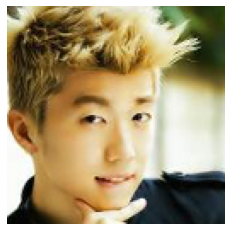

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


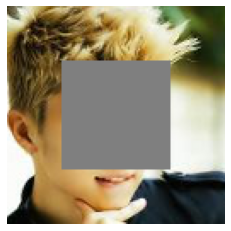

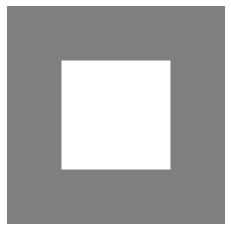

In [21]:
batch = next(iter(celeba_loader))
imshow(batch['gt'][0])
imshow(batch['masked'][0])
imshow(batch['mask'][0])
img = batch['masked'][0]

In [22]:
# valid = mask
#   requires_grad(G, False)
#   requires_grad(D, True)

#   # imshow(valid[0])
#   fake = G(valid)
#   fake_pred = D(fake)

#   gt_pred = D(ground_truth)

#   true_label = torch.ones(ground_truth.shape[0],1)
#   fake_label= true_label*0

#   D.zero_grad()  
#   # print(ground_truth.size(), fake.size())
#   fmloss, D_fake_label, D_gt_label = fml(fake,ground_truth,
#                                          D.local_branch)
#   x1 = D.dense_local_branch(torch.cat(
#                                 [D_fake_label.view(D_fake_label.shape[0],-1) ,
#                                 D_gt_label.view(D_fake_label.shape[0],-1)], 0 ))
  
#   x2 = D.global_branch(torch.cat([fake,ground_truth], 0))
#   # print(x2.size())
#   x2 = D.dense_global_branch( x2.view(x2.shape[0],-1))
#   print(D.neck, x2.size())
#   y = D.neck(torch.cat([x1,x2],1))
#   # print(y.size(), x1.size(), x2.size())
#   D_loss = al(torch.cat([fake_label,true_label]).view(-1), y) + 20*fmloss
#   D_loss.backward()

#   D_opt.step()

#   requires_grad(G, True)
#   requires_grad(D, False)

#   fake = G(valid)
#   fake_pred = D(fake)
  
#   D_fake_label = D(fake)
#   D_true_label = D(ground_truth)
#   # print(mse(fake,ground_truth ))
#   G.zero_grad()
#   G_loss = mse(fake,ground_truth ) \
#       + 20*fml(ground_truth, fake, vgg19(True).features[:5].to(DEVICE))[0] \
#       + sgrl(ground_truth, fake)  + 20*gl(fake, ground_truth )

  
#   G_loss.backward()
#   G_opt.step()

#   return  G_loss, D_loss

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


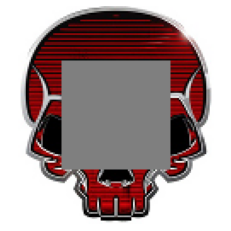

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


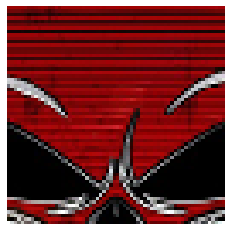

In [23]:
def cut_images(images, masks):
    # mask - рандомно расположенный квадратик размером половины картинки
    return torch.cat([image[mask==1].view(1, 3, mask.shape[1] // 2, mask.shape[2] // 2) \
                         for image, mask in zip(images, masks)], dim=0)

tr = MaskTransform(IMAGE_SIZE)

masked, mask = tr(tr_img)

res = cut_images([tr_img, tr_img], [mask, mask])
imshow(masked)
imshow(res[0])


In [24]:
def requires_grad(model, flag=True):
    for param in model.parameters():
        param.requires_grad = flag

In [25]:
fml = FML()
fml_gen = FML()
# al = AdversialLoss()
# al_gen = AdversialLoss()
gal = GAL()
dal = DAL()
mse = MeanLoss()
sgrl = SGRL()
gl = GeometricLoss()



Downloading: "https://download.pytorch.org/models/vgg19-dcbb9e9d.pth" to /root/.cache/torch/hub/checkpoints/vgg19-dcbb9e9d.pth


In [28]:
D = Discriminator(dis_params).to(DEVICE)
G = Generator(gen_params).to(DEVICE)
chek = torch.load('/content/drive/MyDrive/RaGAN/Gen_15')
G.load_state_dict(chek['model_state_dict'])



<All keys matched successfully>

## Train cikl

In [29]:
def train_D(data, G, D, D_opt, D_sched):

    images = data["gt"].to(DEVICE)
    masked = data["masked"].to(DEVICE)
    masks = data["mask"].to(DEVICE)

    batch_sz = images.size(0)
    
    requires_grad(G, False)
    requires_grad(D, True)

    gen_images = G(masked)
    # gen_predictions = D(gen_images)
    # gt_predictions = D(images)

    cut_gt_images = cut_images(images, masks)
    cut_gen_images = cut_images(gen_images, masks)

    true_label = torch.ones(images.size(0)).to(DEVICE)
    fake_label = torch.zeros_like(true_label).to(DEVICE)

    D.zero_grad()
    fmloss, D_gen_label, D_gt_label = fml(cut_gen_images, cut_gt_images, 
                                            D.local_branch)

    x_local = D.dense_local_branch(torch.cat((D_gen_label.view(batch_sz, -1),
                                        D_gt_label.view(batch_sz, -1)), dim=0))
    
    x_global = D.global_branch(torch.cat((gen_images, images), dim=0))
    x_global = D.dense_global_branch(x_global.view(x_global.size(0), -1))

    y = D.neck(torch.cat([x_local, x_global], dim=1))

    D_loss = 0.003 * dal(torch.cat([fake_label,true_label], dim=0).view(-1), y) + 20*fmloss
    D_loss.backward()
    D_opt.step()

    D_sched.step()

    return D_loss

In [30]:
def train_D1(data, G, D, D_opt, D_sched):

    images = data["gt"].to(DEVICE)
    masked = data["masked"].to(DEVICE)
    masks = data["mask"].to(DEVICE)

    batch_sz = images.size(0)
    
    requires_grad(G, False)
    requires_grad(D, True)

    gen_images = G(masked)
    # gen_predictions = D(gen_images)
    # gt_predictions = D(images)

    cut_gt_images = cut_images(images, masks)
    cut_gen_images = cut_images(gen_images, masks)

    true_label = torch.ones(images.size(0)).to(DEVICE)
    fake_label = torch.zeros_like(true_label).to(DEVICE)

    D.zero_grad()
    # fmloss, D_gen_label, D_gt_label = fml(cut_gen_images, cut_gt_images, 
    #                                         D.local_branch)
    x_local = D.local_branch(torch.cat((cut_gen_images, cut_gt_images),0))
    print(x_local.view(batch_sz, - 1).size(), D.dense_local_branch)
    x_local = D.dense_local_branch(x_local.view(batch_sz, -1))
    
    x_global = D.global_branch(torch.cat((gen_images, images), dim=0))
    x_global = D.dense_global_branch(x_global.view(x_global.size(0), -1))

    y = D.neck(torch.cat([x_local, x_global], dim=1))

    D_loss = 0.003 * dal(torch.cat([fake_label,true_label], dim=0).view(-1), y) 
    D_loss.backward()
    D_opt.step()

    D_sched.step()

    return D_loss

In [31]:
D.dense_local_branch

Sequential(
  (0): Dense2DBlock(
    (block): Sequential(
      (0): Linear(in_features=2048, out_features=512, bias=True)
      (act): NormActBlock(
        (block): Sequential(
          (activation): LeakyReLU(negative_slope=0.01)
        )
      )
    )
  )
)

In [32]:
def train_G(data, G, D, G_opt, G_sched):

    images = data["gt"].to(DEVICE)
    masked = data["masked"].to(DEVICE)
    masks = data["mask"].to(DEVICE)

    batch_sz = images.size(0)

    requires_grad(G, True)
    requires_grad(D, False)

    gen_images = G(masked)

    cut_gt_images = cut_images(images, masks)
    cut_gen_images = cut_images(gen_images, masks)

    gen_predictions = D(gen_images, cut_gen_images)
    gt_predictions = D(images, cut_gt_images)

    true_label = torch.ones(images.size(0)).to(DEVICE)
    fake_label = torch.zeros_like(true_label).to(DEVICE)

    G.zero_grad()

    G_loss = mse(gen_images, images) \
            + 20 * fml(gen_images, images, vgg19(True).features[:5].to(DEVICE))[0] \
            + sgrl(gen_images, images) + 20 * gl(gen_images, images) \
            + 0.003 * gal(torch.cat([fake_label, true_label], dim=0).view(-1),
                    torch.cat([gen_predictions, gt_predictions], dim=0).view(-1))
            
    G_loss.backward()
    G_opt.step()

    # G_sched.step()

    return G_loss

In [33]:
j = 0
def train_epoch(train_loader, G, D, G_opt, D_opt, G_sched, D_sched):
    global j
    j += 1
    running_D_loss = 0.0
    running_G_loss = 0.0
    for i, data in enumerate(train_loader):
        # print(j)
        j += 1
        G.train()
        D.train()
        batch_sz = data["gt"].size(0)

        D_loss = train_D(data, G, D, D_opt, D_sched)
        G_loss = train_G(data, G, D, G_opt, G_sched)

        if j % 20 == 0:
            with torch.no_grad():
                G.eval()
                gen_batch = G(data["masked"].to(DEVICE))
                gen_img = gen_batch[0].to(DEVICE)
                img = data["gt"][0].to(DEVICE)
                f_img = img * (1.0 - data["mask"][0].to(DEVICE)) \
                        + gen_img * data["mask"][0].to(DEVICE)
                
                imshow(img.cpu())
                imshow(gen_img.cpu())
                imshow(f_img.cpu())
                imshow(G(target.view(1, 3, 128, 128).to(DEVICE))[0].cpu())
                imshow(target_gt.cpu())

        running_D_loss += D_loss.item() * batch_sz
        running_G_loss += G_loss.item() * batch_sz
        
    running_D_loss /= len(train_loader.dataset)
    running_G_loss /= len(train_loader.dataset)

    return running_D_loss, running_G_loss

#   fake = G(valid)
#   fake_pred = D(fake)
  
#   D_fake_label = D(fake)
#   D_true_label = D(ground_truth)
#   # print(mse(fake,ground_truth ))
#   G.zero_grad()
#   G_loss = mse(fake,ground_truth ) \
#       + 20*fml(ground_truth, fake, vgg19(True).features[:5].to(DEVICE))[0] \
#       + sgrl(ground_truth, fake)  + 20*gl(fake, ground_truth )

  
#   G_loss.backward()
#   G_opt.step()

#   return  G_loss, D_loss


In [34]:
from tqdm import tqdm
G_opt = torch.optim.AdamW(G.parameters(), lr=1e-5)
D_opt = torch.optim.AdamW(D.parameters(), lr=1e-5)

opt = [G_opt, D_opt]
def train_loop(train_loader, G, D, G_opt, D_opt,epochs=10000, show_progress_bar=True):
    # G_opt = torch.optim.AdamW(G.parameters(), lr=1e-3)
    # D_opt = torch.optim.AdamW(D.parameters(), lr=1e-3)

    G_sched = torch.optim.lr_scheduler.CosineAnnealingLR(G_opt, 2)
    D_sched = torch.optim.lr_scheduler.CosineAnnealingLR(D_opt, 2)

    progress_bar = tqdm(total=epochs)
    loss_history = {'D_loss' : [], 'G_loss' : []}

    for epoch in range(epochs):
        D_loss, G_loss = train_epoch(celeba_loader, G, D, G_opt, D_opt, G_sched, D_sched)

        loss_history['D_loss'].append(D_loss)
        loss_history['G_loss'].append(G_loss)
        progress_bar.set_postfix({"D_loss": D_loss, "G_loss": G_loss})
        progress_bar.update(1)
        if epoch%1==0:
          torch.save({'model_state_dict': G.state_dict(),
            'opt_state_dict': G_opt.state_dict(),}, '/content/drive/MyDrive/RaGAN/Gen_{}'.format(epoch))

    progress_bar.close()
    return loss_history

  0%|          | 0/10000 [00:00<?, ?it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


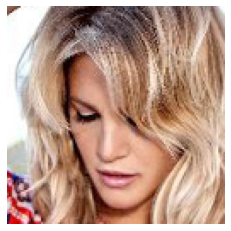

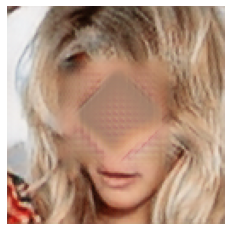

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


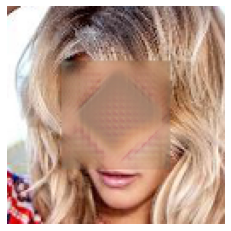

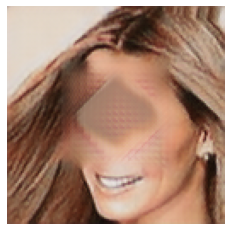

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


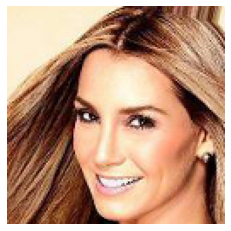

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


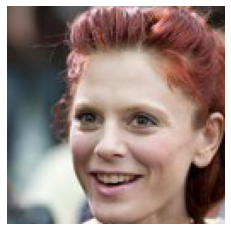

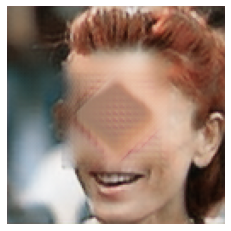

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


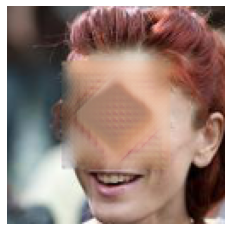

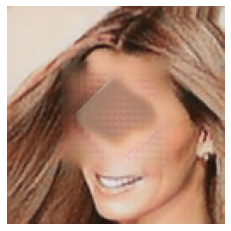

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


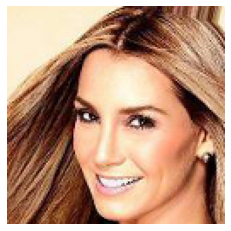

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


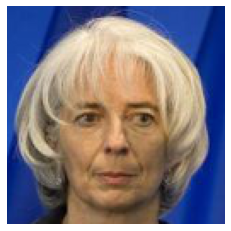

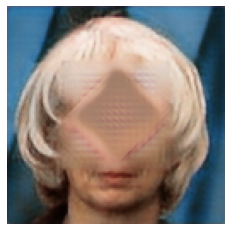

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


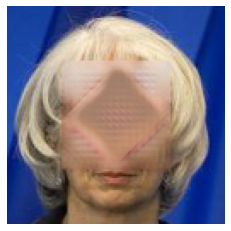

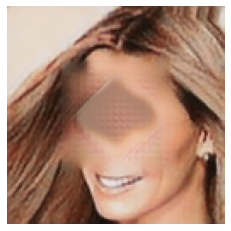

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


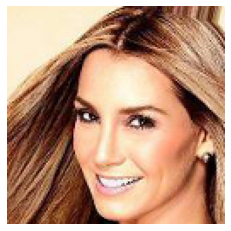

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


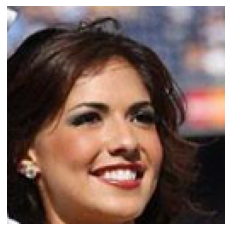

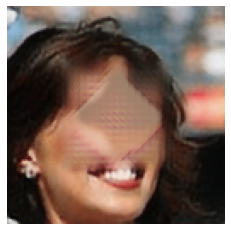

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


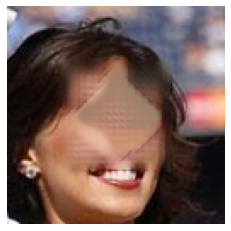

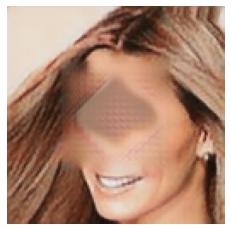

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


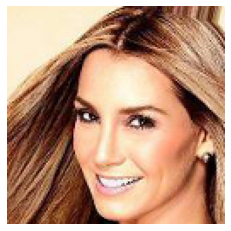

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


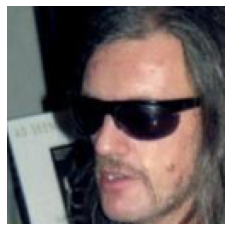

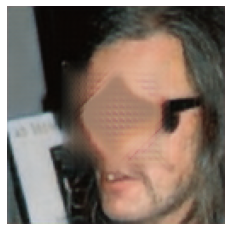

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


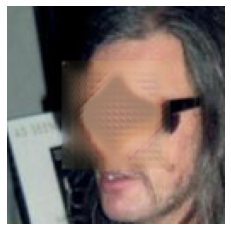

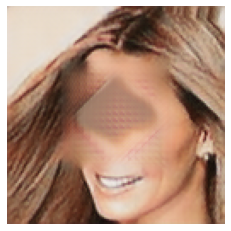

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


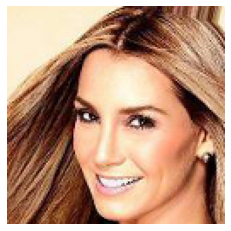

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


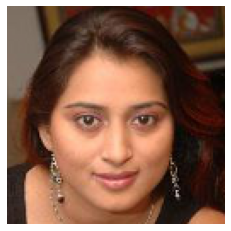

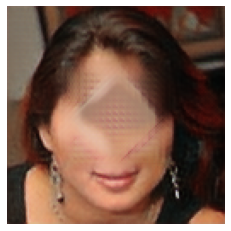

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


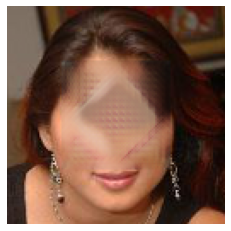

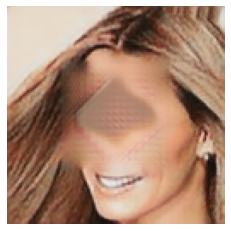

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


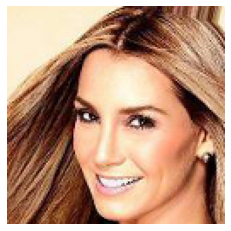

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


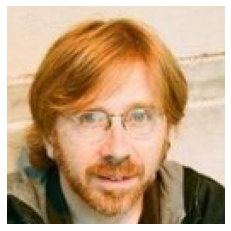

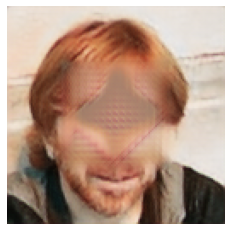

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


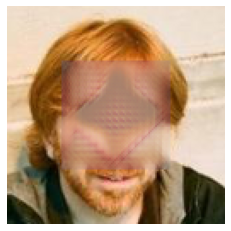

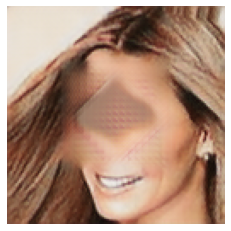

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


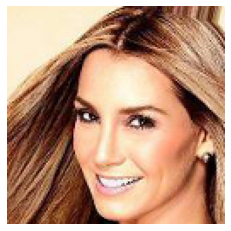

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


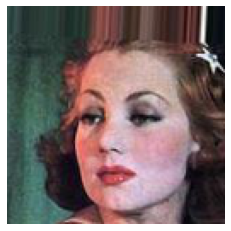

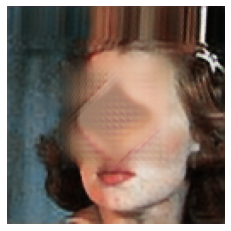

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


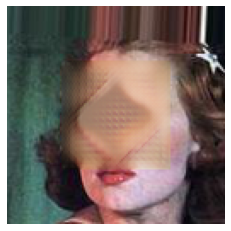

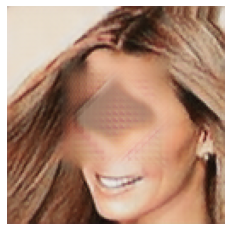

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


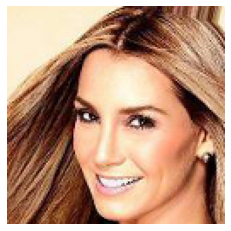

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


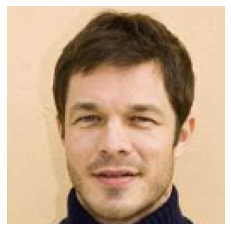

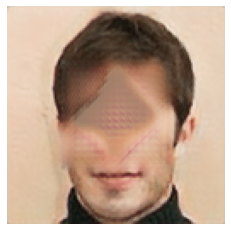

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


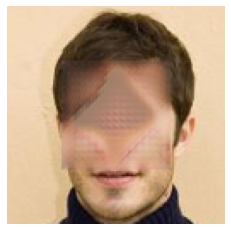

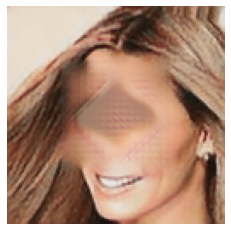

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


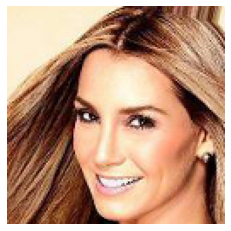

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


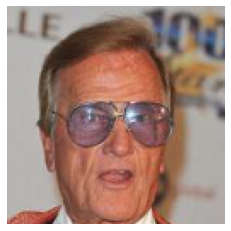

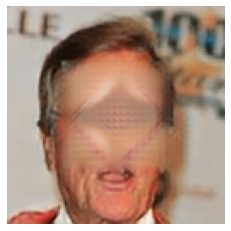

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


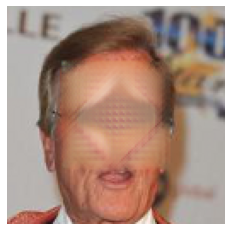

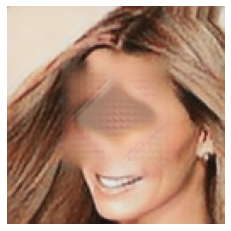

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


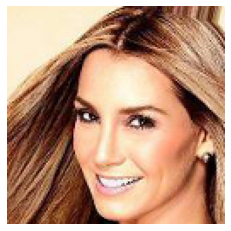

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


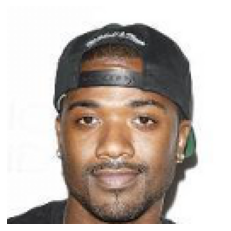

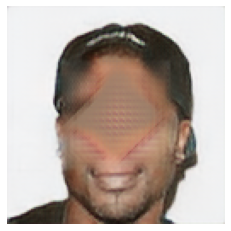

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


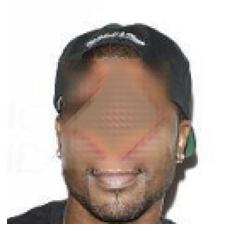

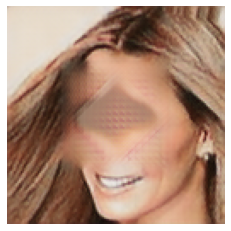

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


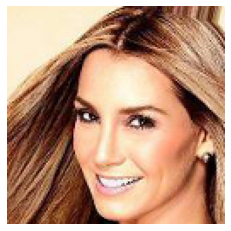

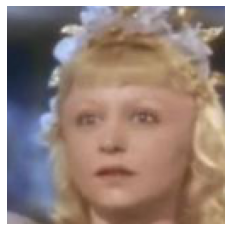

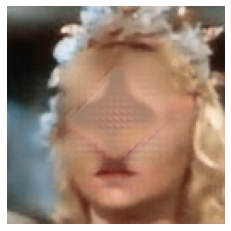

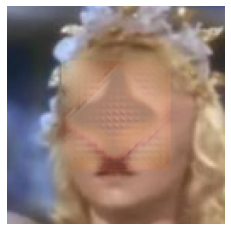

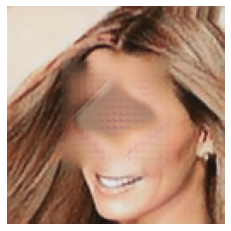

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


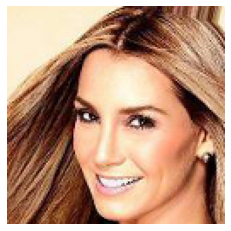

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


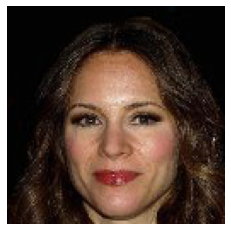

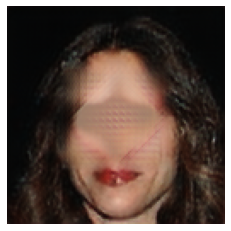

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


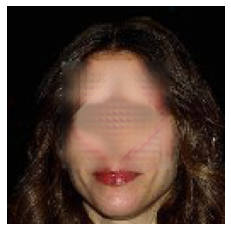

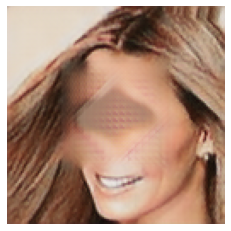

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


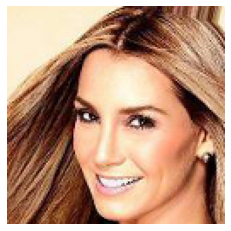

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


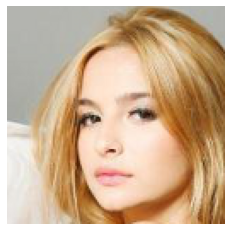

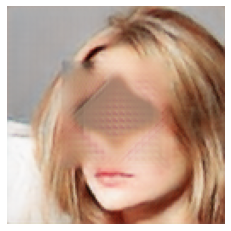

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


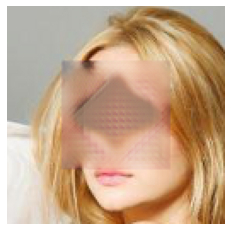

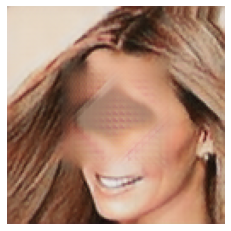

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


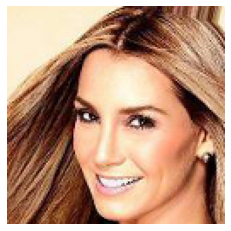

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


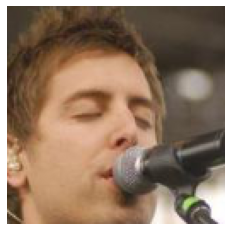

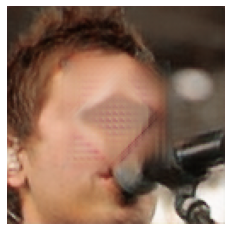

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


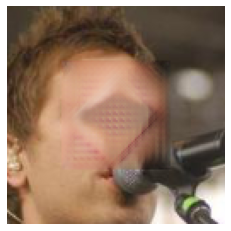

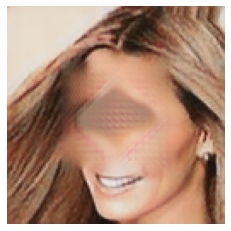

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


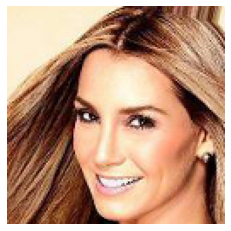

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


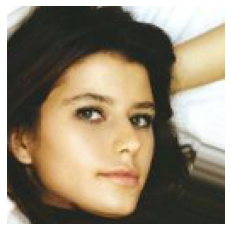

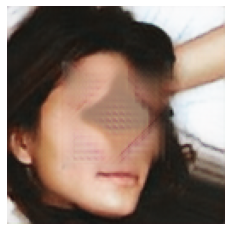

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


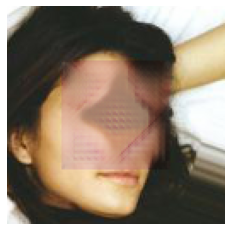

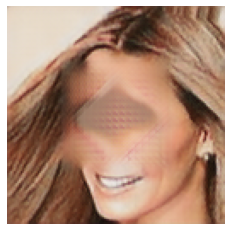

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


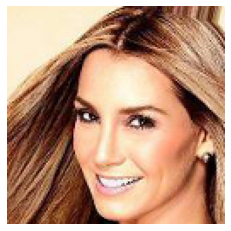

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


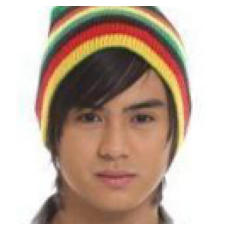

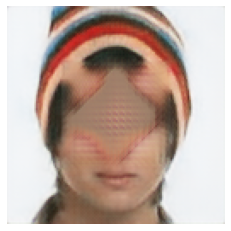

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


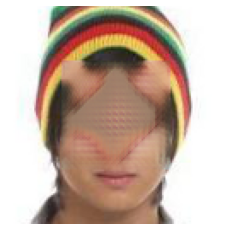

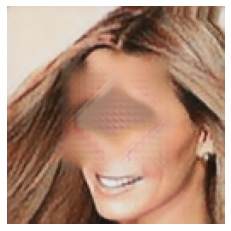

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


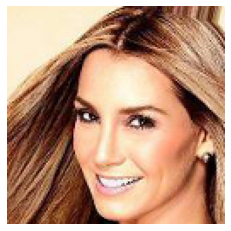

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


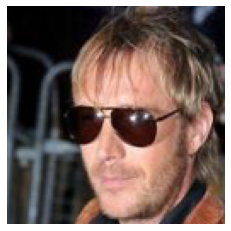

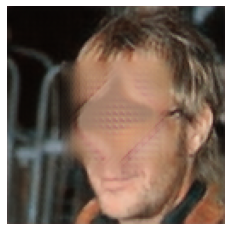

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


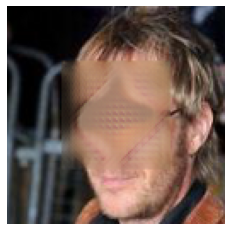

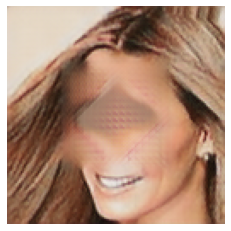

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


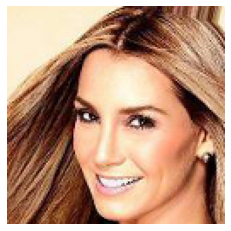

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


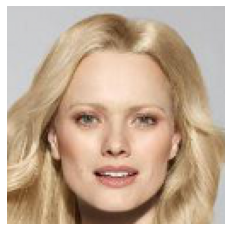

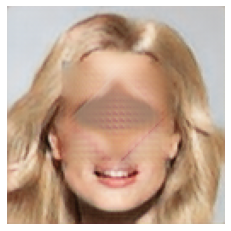

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


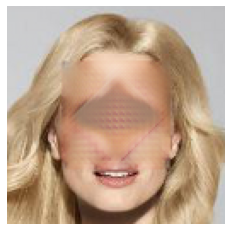

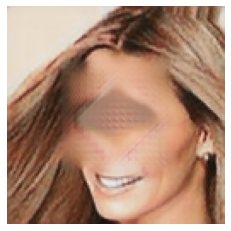

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


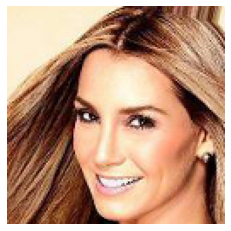

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


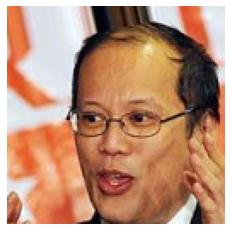

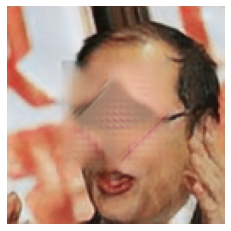

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


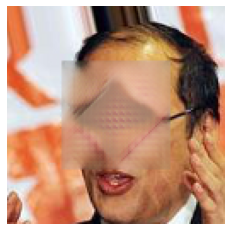

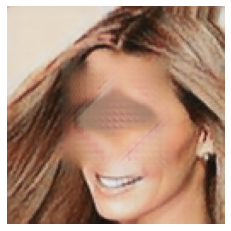

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


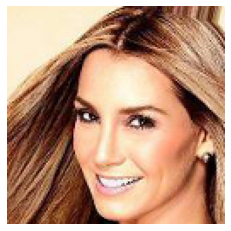

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


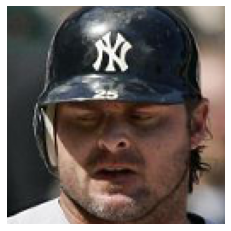

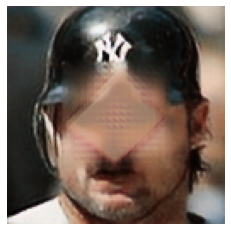

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


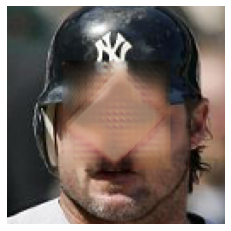

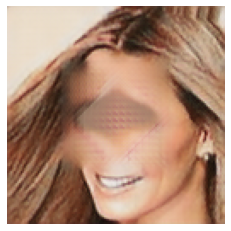

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


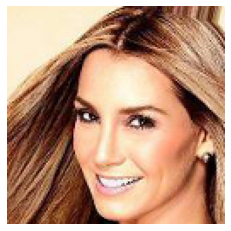

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


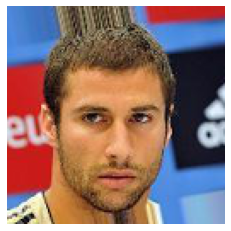

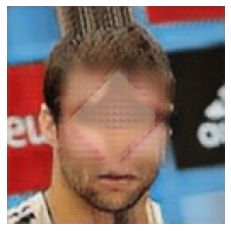

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


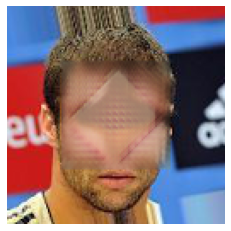

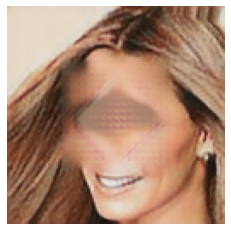

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


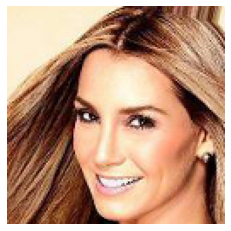

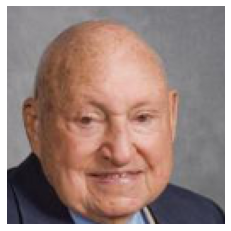

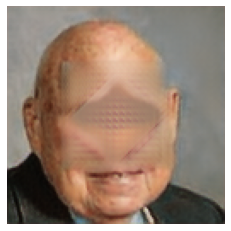

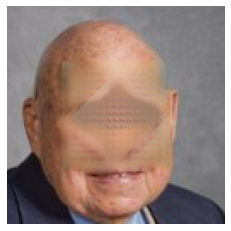

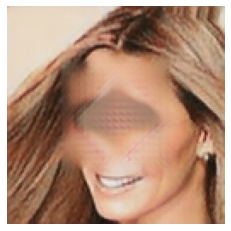

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


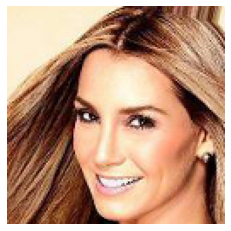

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


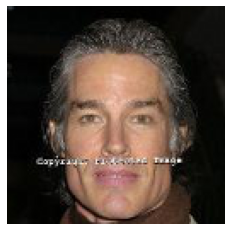

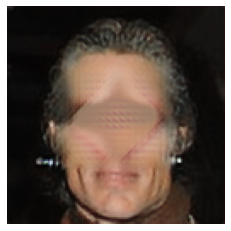

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


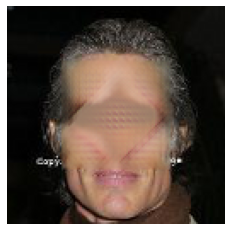

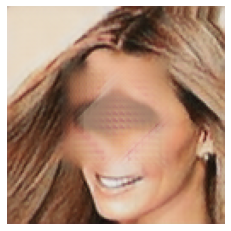

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


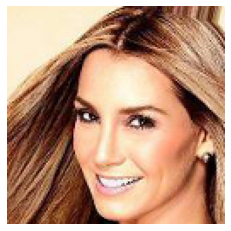

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


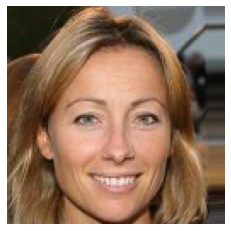

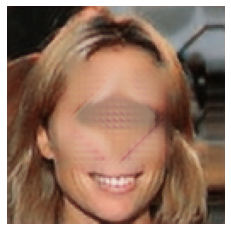

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


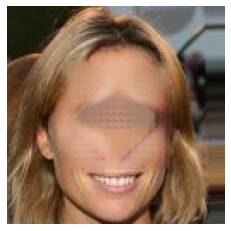

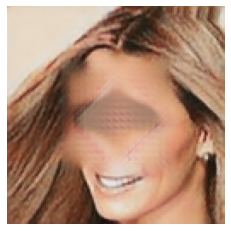

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


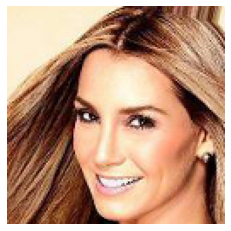

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


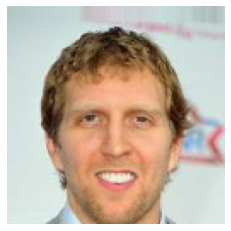

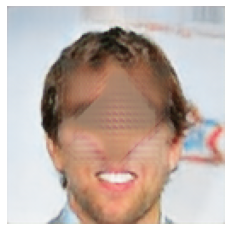

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


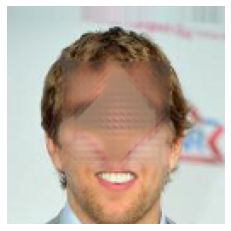

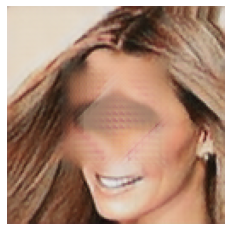

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


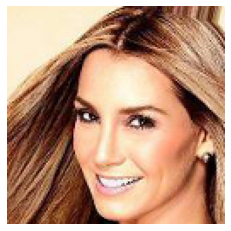

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


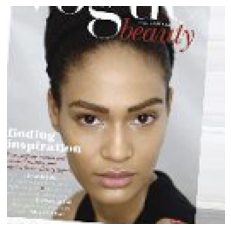

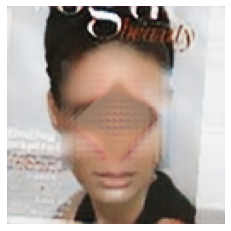

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


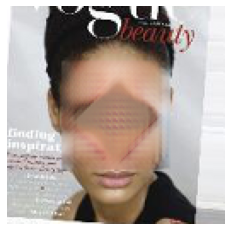

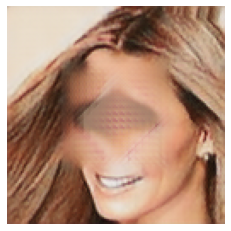

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


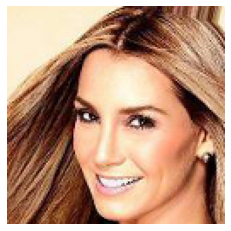

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


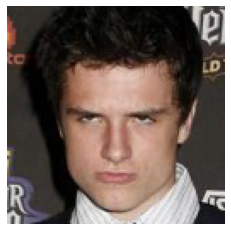

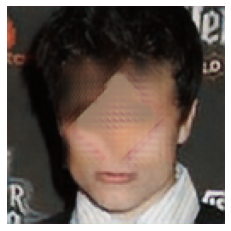

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


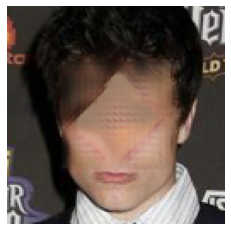

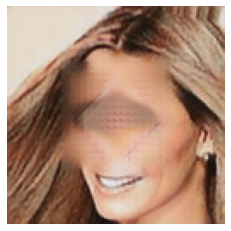

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


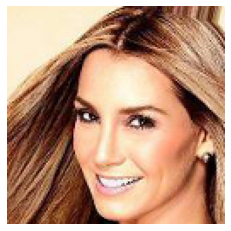

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


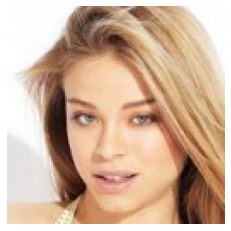

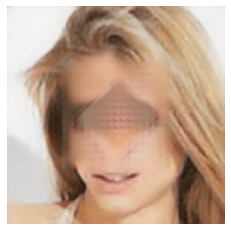

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


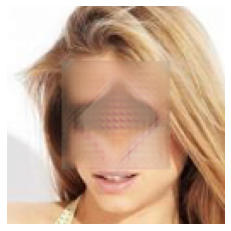

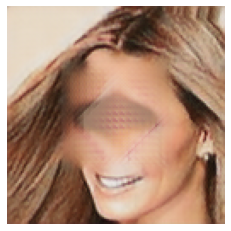

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


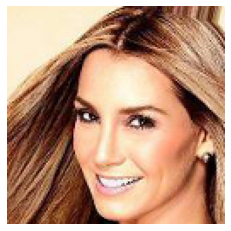

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


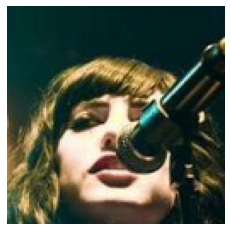

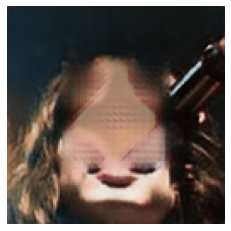

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


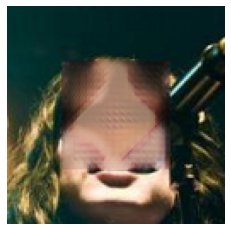

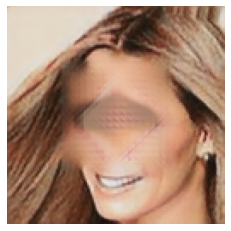

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


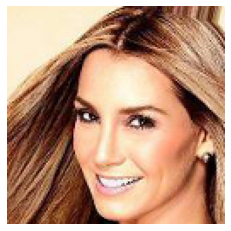

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


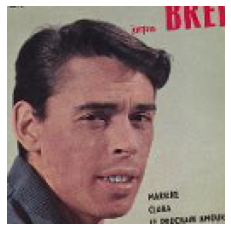

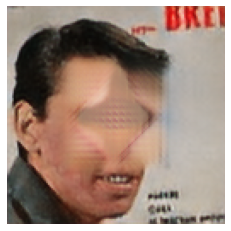

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


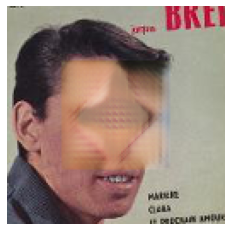

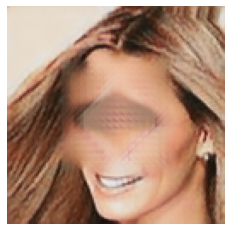

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


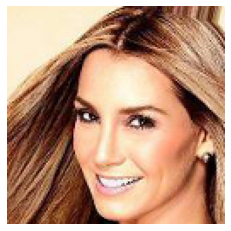

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


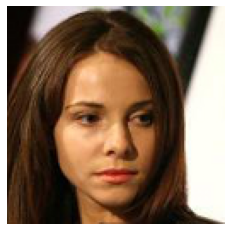

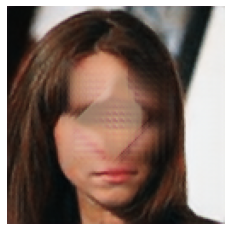

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


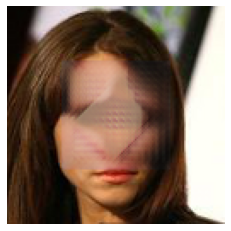

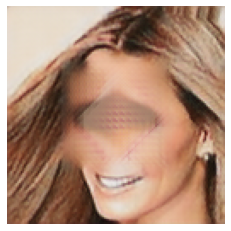

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


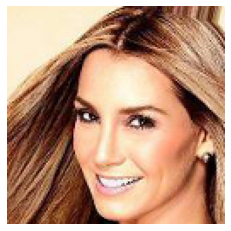

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


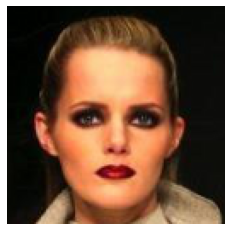

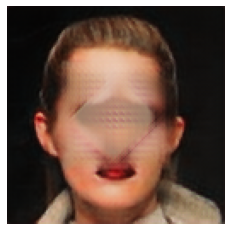

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


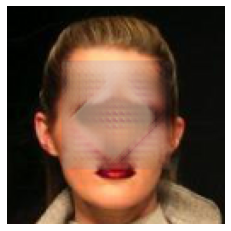

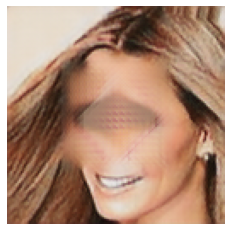

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


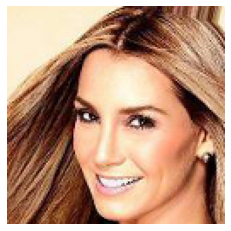

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


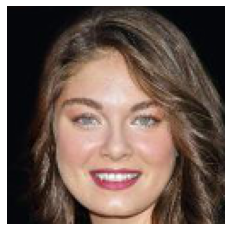

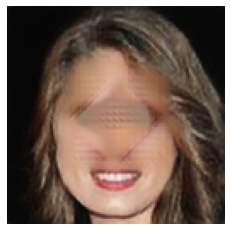

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


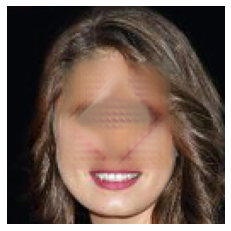

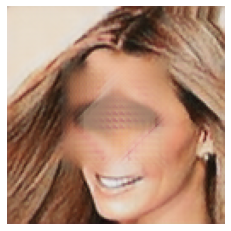

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


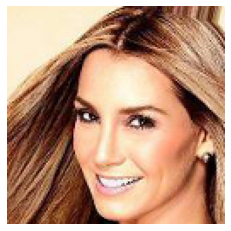

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


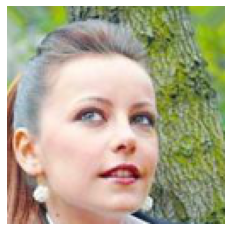

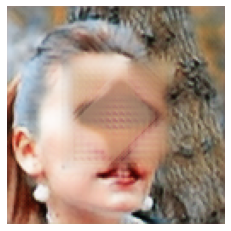

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


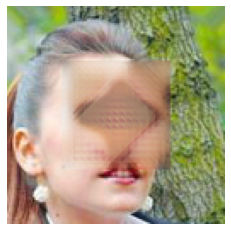

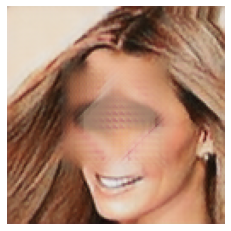

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


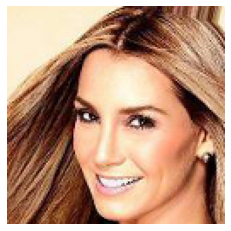

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


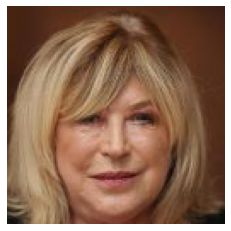

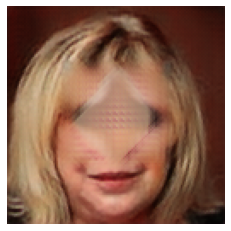

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


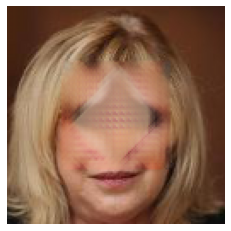

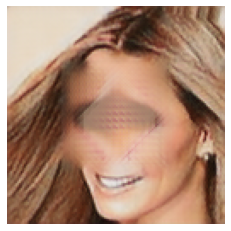

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


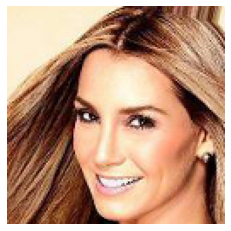

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


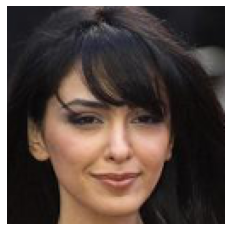

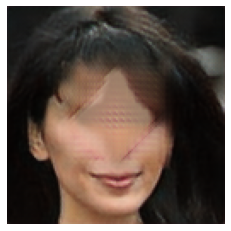

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


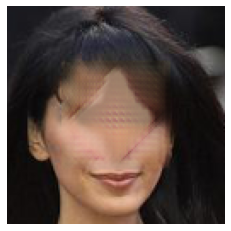

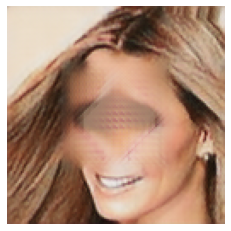

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


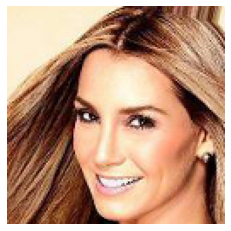

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


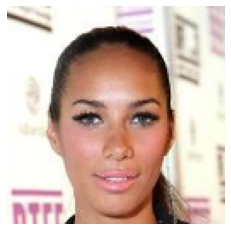

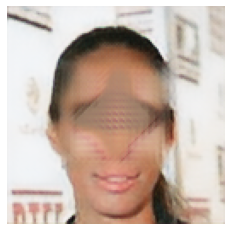

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


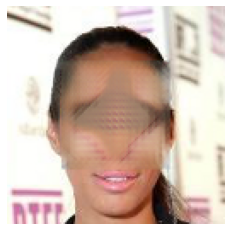

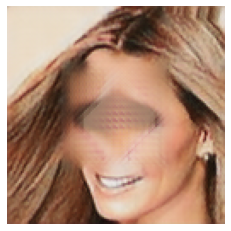

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


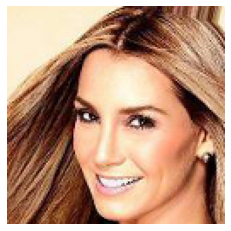

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


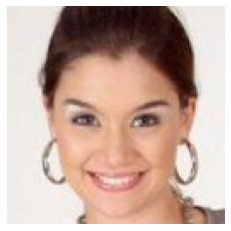

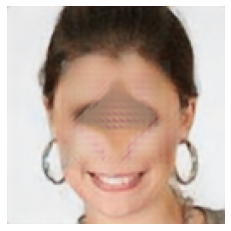

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


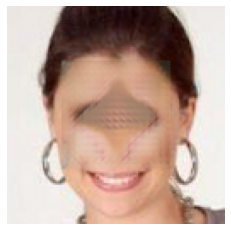

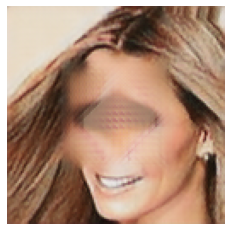

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


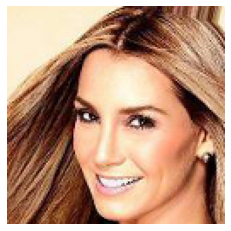

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


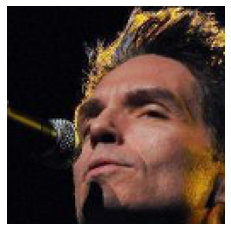

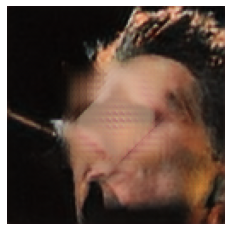

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


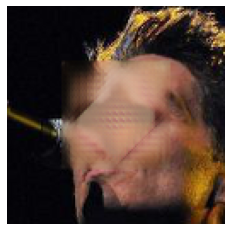

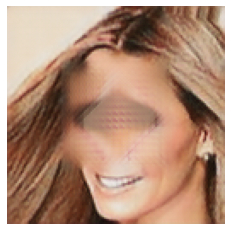

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


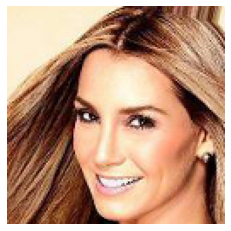

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


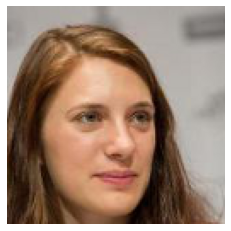

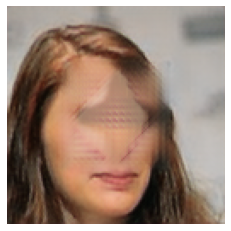

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


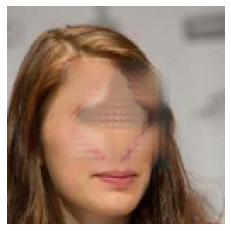

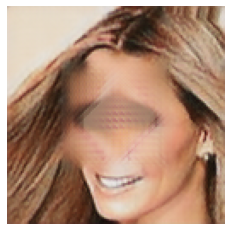

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


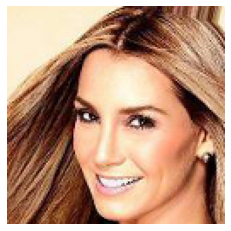

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


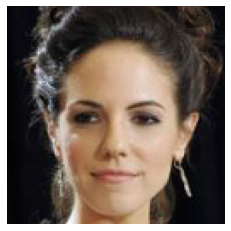

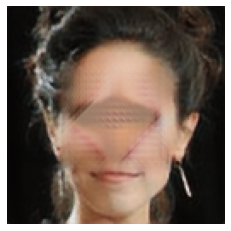

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


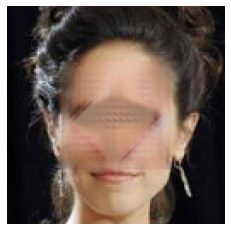

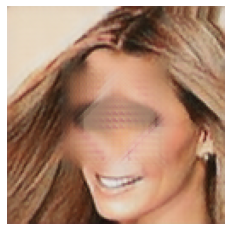

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


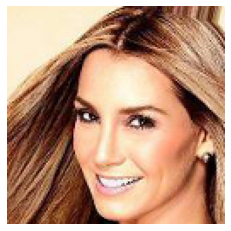

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


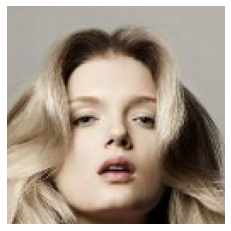

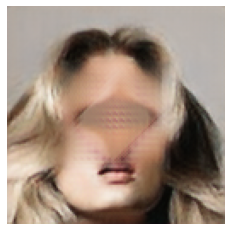

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


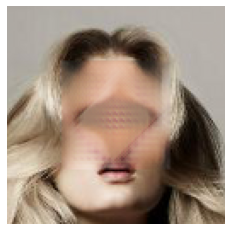

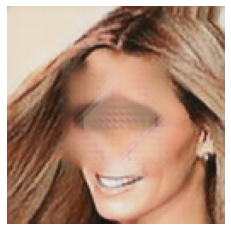

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


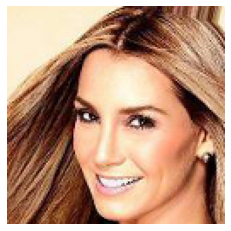

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


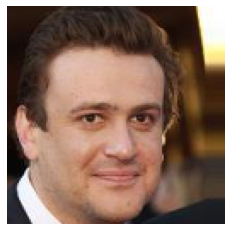

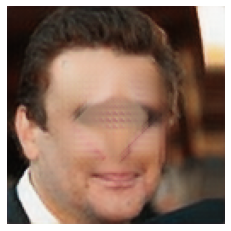

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


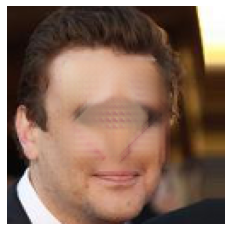

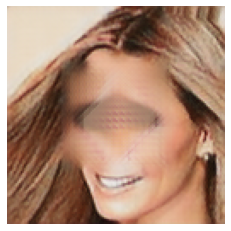

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


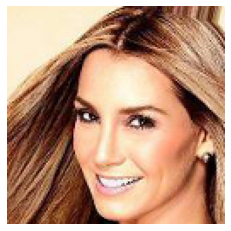

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


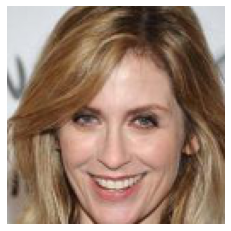

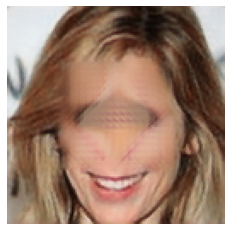

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


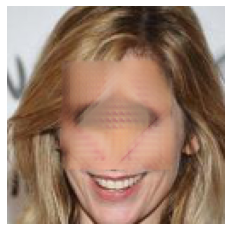

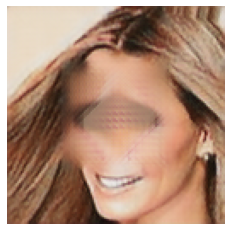

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


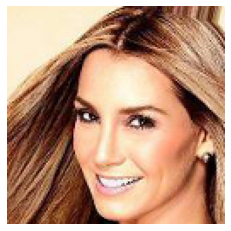

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


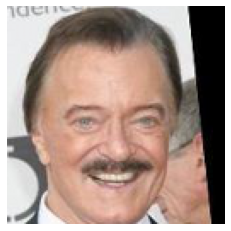

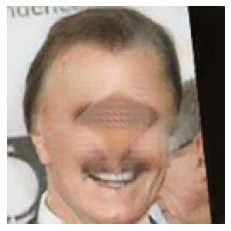

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


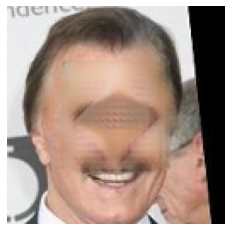

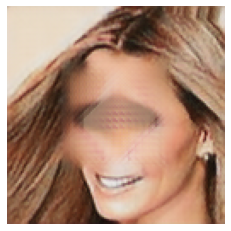

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


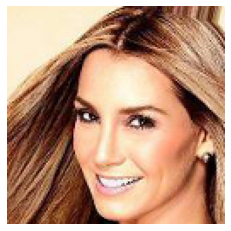

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


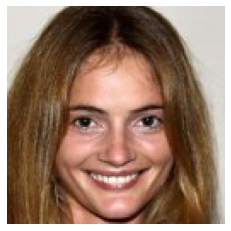

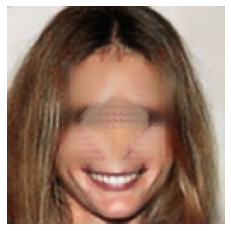

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


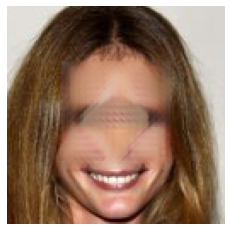

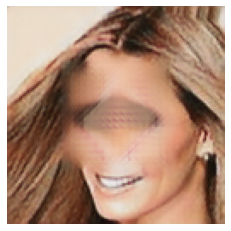

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


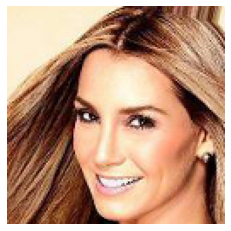

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


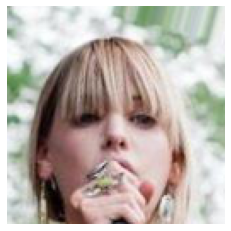

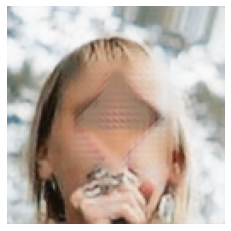

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


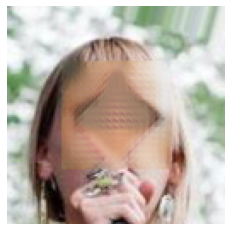

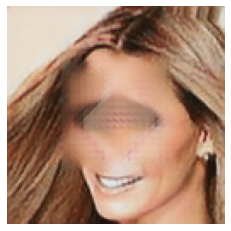

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


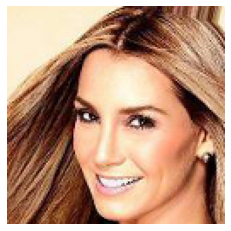

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


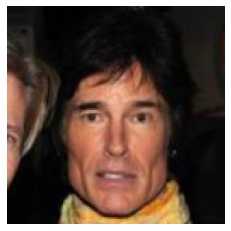

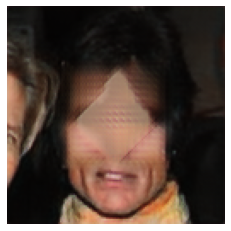

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


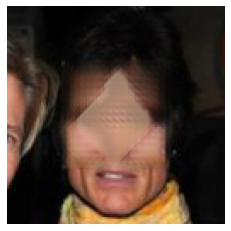

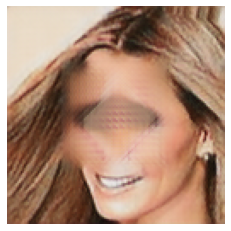

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


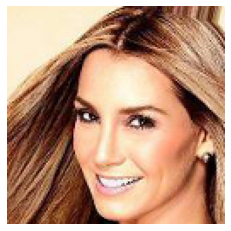

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


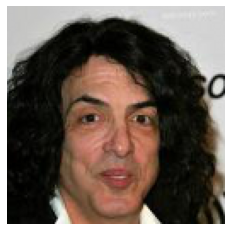

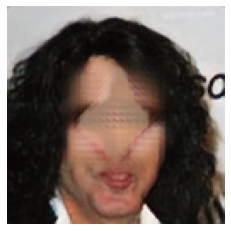

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


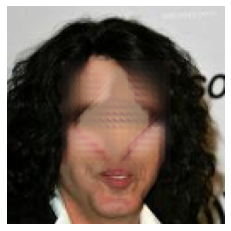

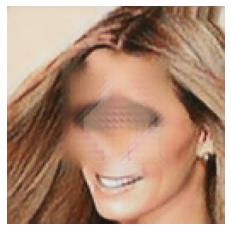

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


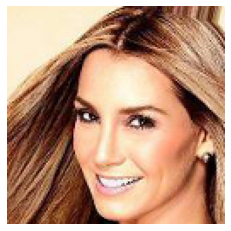

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


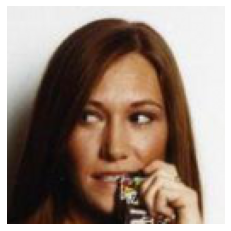

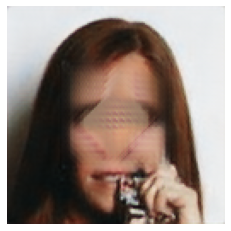

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


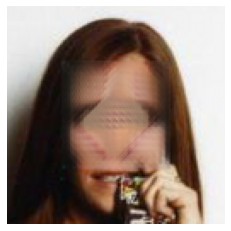

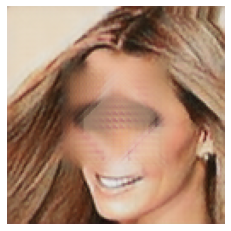

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


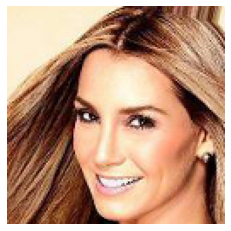

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


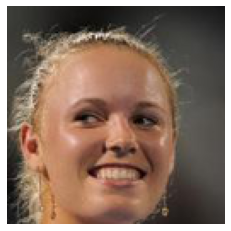

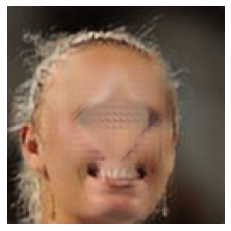

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


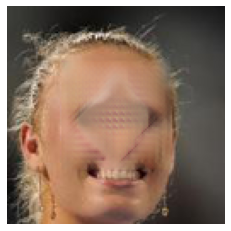

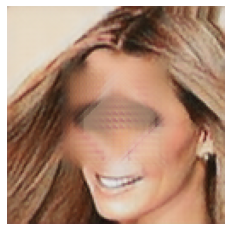

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


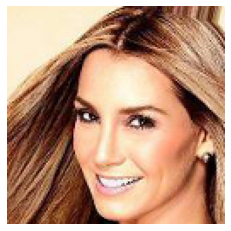

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


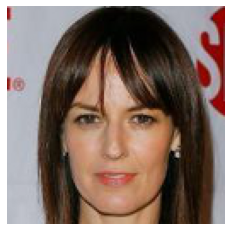

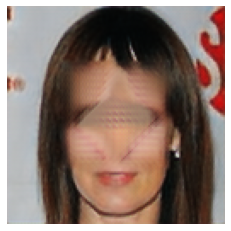

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


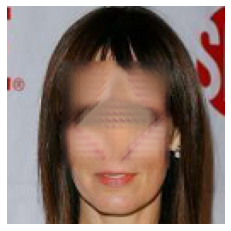

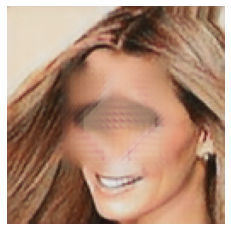

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


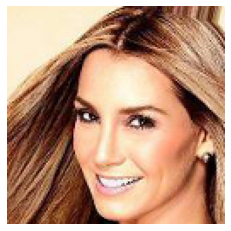

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


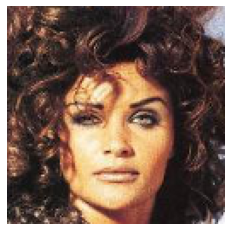

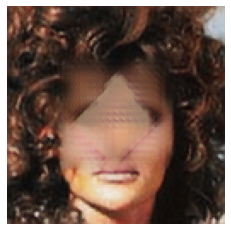

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


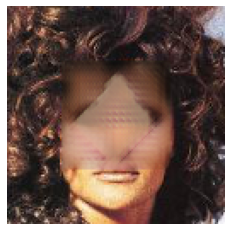

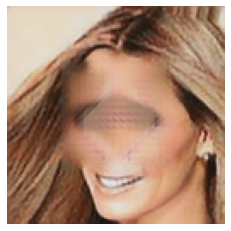

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


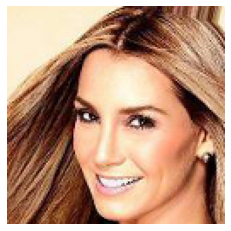

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


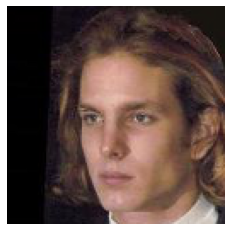

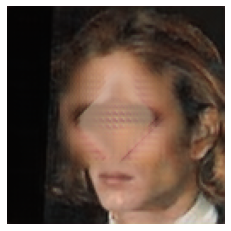

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


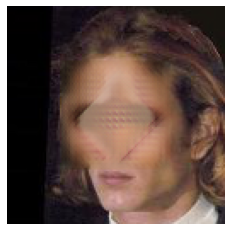

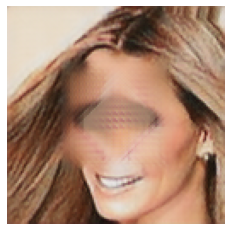

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


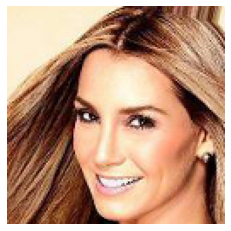

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


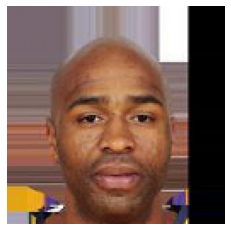

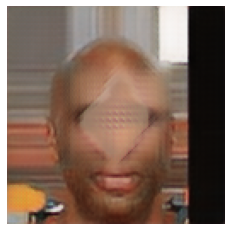

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


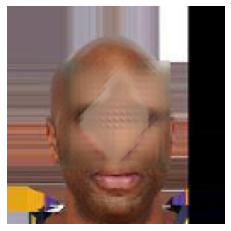

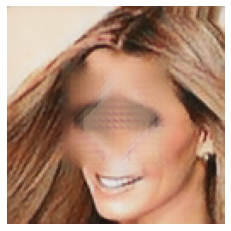

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


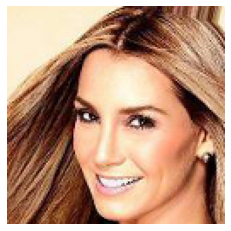

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


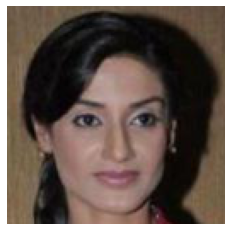

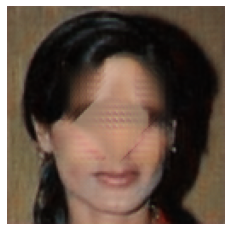

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


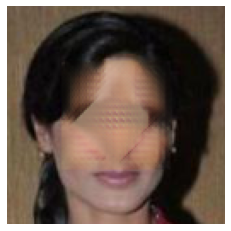

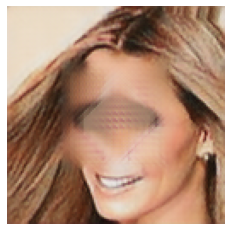

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


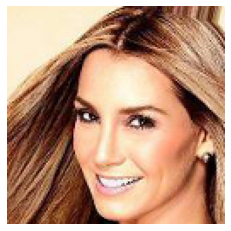

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


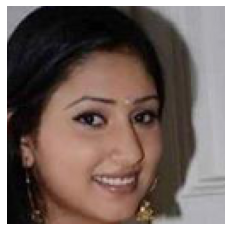

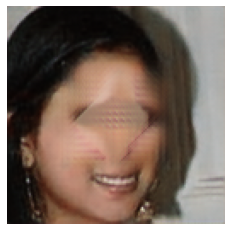

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


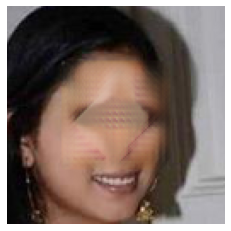

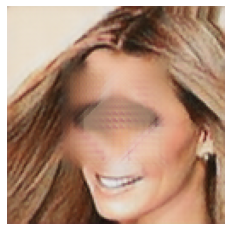

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


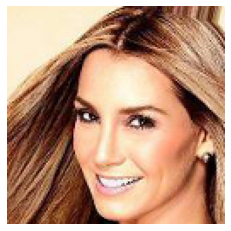

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


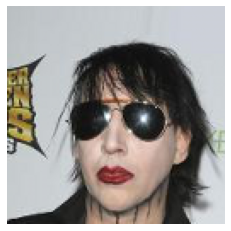

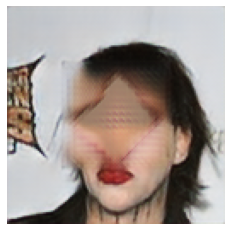

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


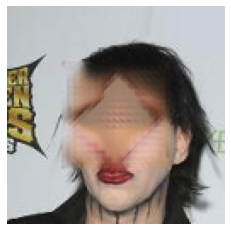

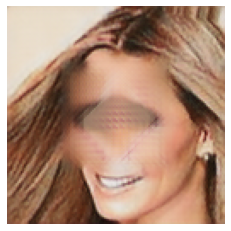

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


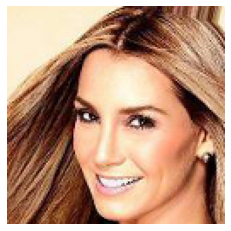

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


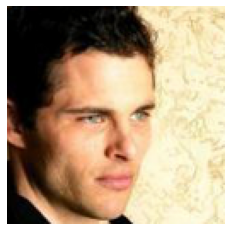

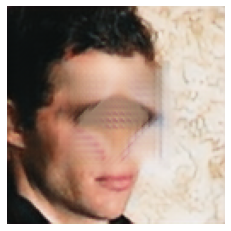

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


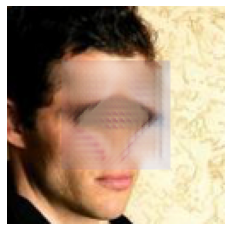

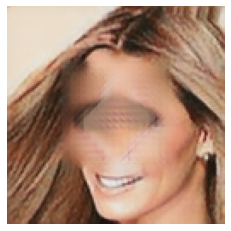

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


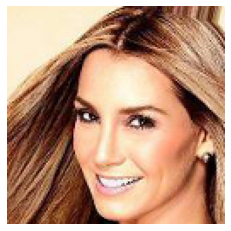

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


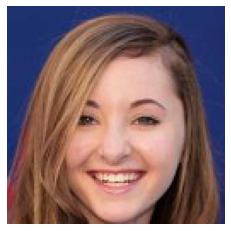

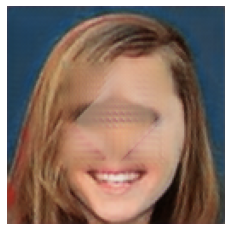

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


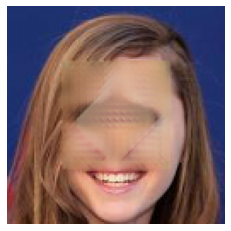

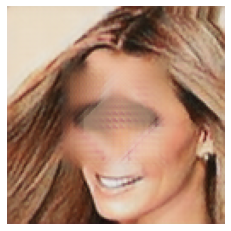

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


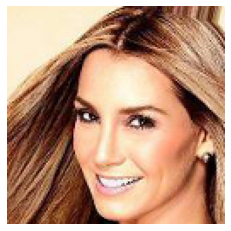

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


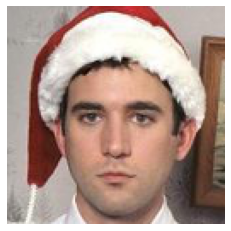

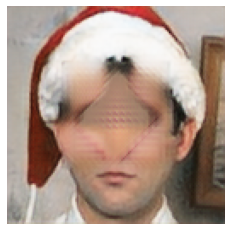

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


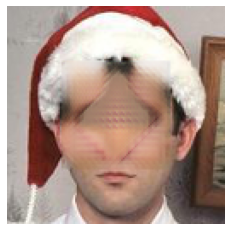

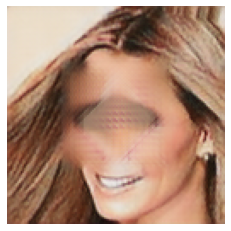

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


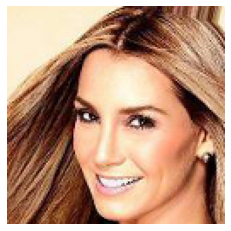

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


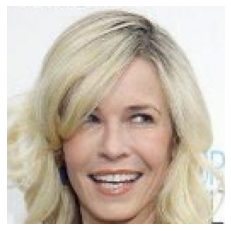

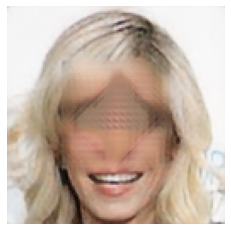

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


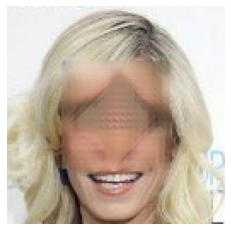

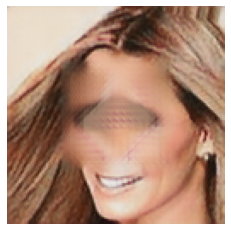

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


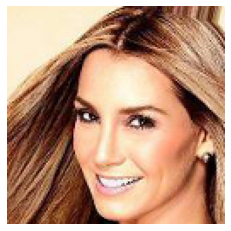

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


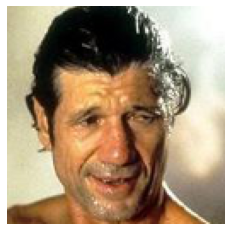

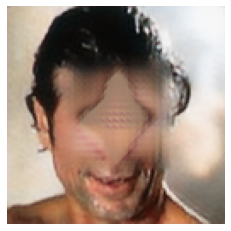

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


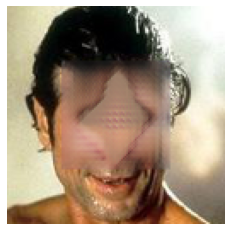

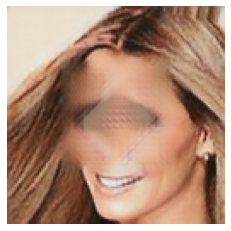

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


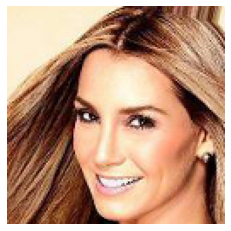

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


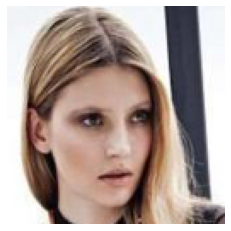

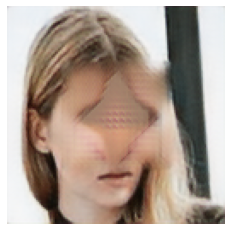

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


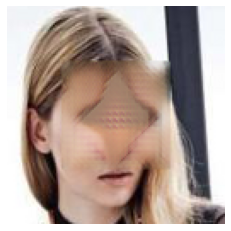

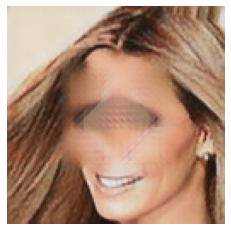

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


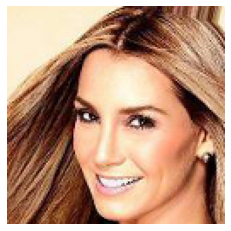

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


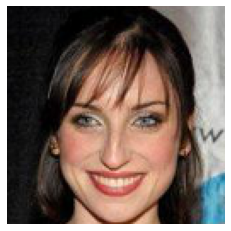

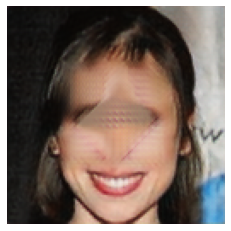

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


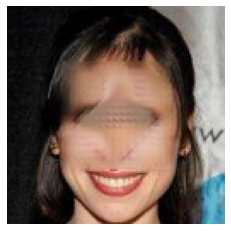

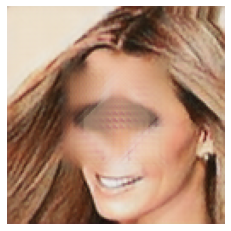

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


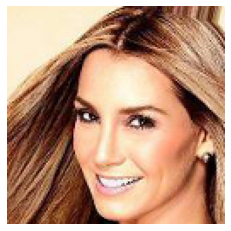

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


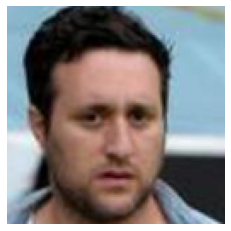

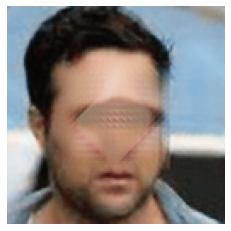

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


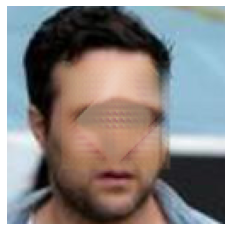

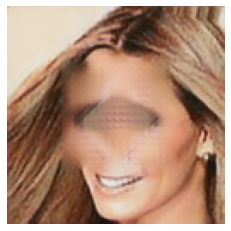

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


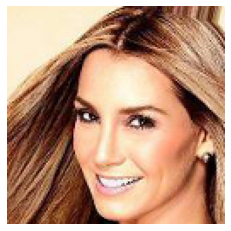

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


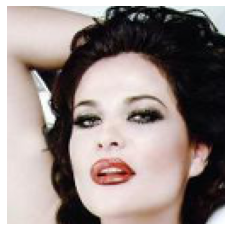

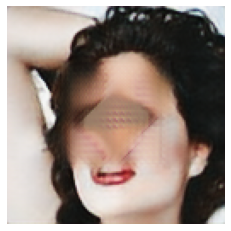

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


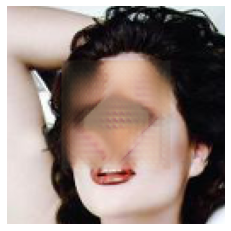

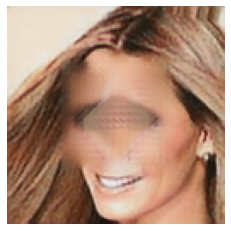

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


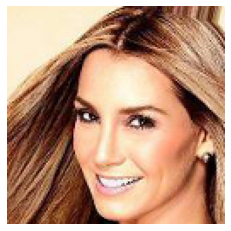

In [ ]:
loss_history = train_loop(celeba_loader, G, D, *opt,epochs=10000, show_progress_bar=True, )
# D.dense_local_branch


###ghghgh

#fg

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

In [ ]:
torch.save({'model_state_dict': G.state_dict(),
            'opt_state_dict': G_opt.state_dict(),}, '/content/drive/MyDrive/RaGAN/Gen')

In [ ]:
import os
os.mkdir('/content/drive/MyDrive/RaGAN/pics')

In [ ]:
torch.manual_seed(0)

In [ ]:
for image in celeba_loader:
    mask = image["mask"].to(DEVICE)
    print(D(image["masked"].to(DEVICE), cut_images(image["gt"].to(DEVICE), mask).to(DEVICE)))
    print(D(image["gt"].to(DEVICE), cut_images(image["gt"].to(DEVICE), mask).to(DEVICE)))
    break

In [ ]:
torch.save({'model_state_dict': G.state_dict()}, '/content/Gen')

In [ ]:
chek = torch.load('/content/drive/MyDrive/RaGAN/Gen_15')
gg = Generator(gen)
gg.load_state_dict(chek['model_state_dict'])
imshow(gg(torch.unsqueeze(img,0)).detach()[0])